<a href="https://colab.research.google.com/github/HarmanBhutani/ML_projects/blob/main/Assignment_DataScience.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Installing all required packages

In [11]:
pip install nltk

In [12]:
pip install contractions

In [13]:
!pip install autocorrect

Importing packages !

In [90]:
import pandas as pd
import numpy as np
import csv
from bs4 import BeautifulSoup
import contractions
import nltk
from nltk.corpus import stopwords
from autocorrect import Speller
import spacy
import matplotlib.pyplot as plt

## Part 1

Load the data

In [15]:
df = pd.read_csv('movie_review.tsv', header=0, delimiter="\t", quoting=csv.QUOTE_NONE)
df.head(10)

,id,review
0,"""9999_0""","""Watching Time Chasers, it obvious that it was..."
1,"""45057_0""","""I saw this film about 20 years ago and rememb..."
2,"""15561_0""","""Minor Spoilers<br /><br />In New York, Joan B..."
3,"""7161_0""","""I went to see this film with a great deal of ..."
4,"""43971_0""","""Yes, I agree with everyone on this site this ..."
5,"""36495_0""","""Jennifer Ehle was sparkling in \""Pride and Pr..."
6,"""49472_0""","""Amy Poehler is a terrific comedian on Saturda..."
7,"""36693_0""","""A plane carrying employees of a large biotech..."
8,"""316_0""","""A well made, gritty science fiction movie, it..."
9,"""32454_0""","""Incredibly dumb and utterly predictable story..."


Removing the id column and using only the review column

In [16]:
fields = ['review']

In [17]:
dataframe = pd.read_csv('movie_review.tsv', header=0, delimiter="\t", usecols=fields , quoting=csv.QUOTE_NONE)
dataframe.head(10)

,review
0,"""Watching Time Chasers, it obvious that it was..."
1,"""I saw this film about 20 years ago and rememb..."
2,"""Minor Spoilers<br /><br />In New York, Joan B..."
3,"""I went to see this film with a great deal of ..."
4,"""Yes, I agree with everyone on this site this ..."
5,"""Jennifer Ehle was sparkling in \""Pride and Pr..."
6,"""Amy Poehler is a terrific comedian on Saturda..."
7,"""A plane carrying employees of a large biotech..."
8,"""A well made, gritty science fiction movie, it..."
9,"""Incredibly dumb and utterly predictable story..."


In [18]:
len(dataframe)

50000

Removing unnecessary tag elements

Now removing tag elements as shown in below example , 2nd row of data frame has html tags such as br tag

In [19]:
dataframe.loc[2,'review']

'"Minor Spoilers<br /><br />In New York, Joan Barnard (Elvire Audrey) is informed that her husband, the archeologist Arthur Barnard (John Saxon), was mysteriously murdered in Italy while searching an Etruscan tomb. Joan decides to travel to Italy, in the company of her colleague, who offers his support. Once in Italy, she starts having visions relative to an ancient people and maggots, many maggots. After shootings and weird events, Joan realizes that her father is an international drug dealer, there are drugs hidden in the tomb and her colleague is a detective of the narcotic department. The story ends back in New York, when Joan and her colleague decide to get married with each other, in a very romantic end. Yesterday I had the displeasure of wasting my time watching this crap. The story is so absurd, mixing thriller, crime, supernatural and horror (and even a romantic end) in a non-sense way. The acting is the worst possible, highlighting the horrible performance of the beautiful El

In [21]:
import re
def Clean_html_text(raw_html):
  cleanr = re.compile('<.*?>')
  html_free_review = re.sub(cleanr, ' ', raw_html)
  return html_free_review

In [22]:
L  = []
for i in range (0,len(dataframe)):
  b = dataframe.loc[i,'review']
  soup = Clean_html_text(b)
  L.append(soup)

In [23]:
data_f = pd.DataFrame(L, columns=['review'])

After using the above regx , we can see that all html tags are removed !

In [24]:
data_f.loc[2,'review']

'"Minor Spoilers  In New York, Joan Barnard (Elvire Audrey) is informed that her husband, the archeologist Arthur Barnard (John Saxon), was mysteriously murdered in Italy while searching an Etruscan tomb. Joan decides to travel to Italy, in the company of her colleague, who offers his support. Once in Italy, she starts having visions relative to an ancient people and maggots, many maggots. After shootings and weird events, Joan realizes that her father is an international drug dealer, there are drugs hidden in the tomb and her colleague is a detective of the narcotic department. The story ends back in New York, when Joan and her colleague decide to get married with each other, in a very romantic end. Yesterday I had the displeasure of wasting my time watching this crap. The story is so absurd, mixing thriller, crime, supernatural and horror (and even a romantic end) in a non-sense way. The acting is the worst possible, highlighting the horrible performance of the beautiful Elvire Audre

In [28]:
data_f.head(10)

,review
0,"""Watching Time Chasers, it obvious that it was..."
1,"""I saw this film about 20 years ago and rememb..."
2,"""Minor Spoilers In New York, Joan Barnard (El..."
3,"""I went to see this film with a great deal of ..."
4,"""Yes, I agree with everyone on this site this ..."
5,"""Jennifer Ehle was sparkling in \""Pride and Pr..."
6,"""Amy Poehler is a terrific comedian on Saturda..."
7,"""A plane carrying employees of a large biotech..."
8,"""A well made, gritty science fiction movie, it..."
9,"""Incredibly dumb and utterly predictable story..."


Removing Punctuations

In [29]:
data_f['review']

0        "Watching Time Chasers, it obvious that it was...
1        "I saw this film about 20 years ago and rememb...
2        "Minor Spoilers  In New York, Joan Barnard (El...
3        "I went to see this film with a great deal of ...
4        "Yes, I agree with everyone on this site this ...
                               ...                        
49995    "The original Man Eater by Joe D'Amato is some...
49996    "When Home Box Office was in it's early days m...
49997    "Griffin Dunne was born into a cultural family...
49998    "Not a bad story, but the low budget rears its...
49999    "This not-very-good mummy-alien flick does fea...
Name: review, Length: 50000, dtype: object

In [30]:
data_f.loc[2,'review']

'"Minor Spoilers  In New York, Joan Barnard (Elvire Audrey) is informed that her husband, the archeologist Arthur Barnard (John Saxon), was mysteriously murdered in Italy while searching an Etruscan tomb. Joan decides to travel to Italy, in the company of her colleague, who offers his support. Once in Italy, she starts having visions relative to an ancient people and maggots, many maggots. After shootings and weird events, Joan realizes that her father is an international drug dealer, there are drugs hidden in the tomb and her colleague is a detective of the narcotic department. The story ends back in New York, when Joan and her colleague decide to get married with each other, in a very romantic end. Yesterday I had the displeasure of wasting my time watching this crap. The story is so absurd, mixing thriller, crime, supernatural and horror (and even a romantic end) in a non-sense way. The acting is the worst possible, highlighting the horrible performance of the beautiful Elvire Audre

Before Punctuations removal , we can see there are many special symbols available such as !()-[]{};:'"\,<>/?@#$%^&*_~


In [31]:
data_f['review'] = data_f['review'].str.replace('[^\w\s.]','')
data_f['review']

0        Watching Time Chasers it obvious that it was m...
1        I saw this film about 20 years ago and remembe...
2        Minor Spoilers  In New York Joan Barnard Elvir...
3        I went to see this film with a great deal of e...
4        Yes I agree with everyone on this site this mo...
                               ...                        
49995    The original Man Eater by Joe DAmato is somewh...
49996    When Home Box Office was in its early days mov...
49997    Griffin Dunne was born into a cultural family....
49998    Not a bad story but the low budget rears its u...
49999    This notverygood mummyalien flick does feature...
Name: review, Length: 50000, dtype: object

In [32]:
#  my_str = data_f.loc[2,'review']
# for char in my_str:
#   if char not in punctuations:
#     no_punct = no_punct + char
# punct_data.append(no_punct)


In [33]:
# no_punct = ""

In [34]:
# my_str = ""

In [35]:
# punctuations = '''!()-[]{};:'"\,<>/?@#$%^&*_~'''

In [36]:
# punct_data = []

In [37]:
# # for i in range (0,len(data_f)):
#   my_str = data_f.loc[2,'review']
#   for char in my_str:
#     if char not in punctuations:
#       no_punct = no_punct + char
#       punct_data.append(no_punct)

In [38]:
# data_punch = pd.DataFrame(punct_data, columns=['review'])

In [39]:
data_f['review'][2]

'Minor Spoilers  In New York Joan Barnard Elvire Audrey is informed that her husband the archeologist Arthur Barnard John Saxon was mysteriously murdered in Italy while searching an Etruscan tomb. Joan decides to travel to Italy in the company of her colleague who offers his support. Once in Italy she starts having visions relative to an ancient people and maggots many maggots. After shootings and weird events Joan realizes that her father is an international drug dealer there are drugs hidden in the tomb and her colleague is a detective of the narcotic department. The story ends back in New York when Joan and her colleague decide to get married with each other in a very romantic end. Yesterday I had the displeasure of wasting my time watching this crap. The story is so absurd mixing thriller crime supernatural and horror and even a romantic end in a nonsense way. The acting is the worst possible highlighting the horrible performance of the beautiful Elvire Audrey. John Saxon just give

In the above review , as we can see all punctions are removed successfully.

Contractions

In [40]:
import contractions

In [41]:
data_f['review'][7]

'A plane carrying employees of a large biotech firmincluding the CEOs daughtergoes down in thick forest in the Pacific Northwest. When the search and rescue mission is called off the CEO Harlan Knowles Lance Henriksen puts together a small ragtag group to execute their own search and rescue mission. But just what is Knowles searching for and trying to rescue and just what is following and watching them in the woods   Oy what a mess this film was It was a shame because for one it stars Lance Henriksen who is one of my favorite modern genre actors and two it could have easily been a decent film. It suffers from two major flaws and theyre probably both writerdirector Jonas Quastels faultthis film which Ill be calling by its aka of Sasquatch has just about the worst editing Ive ever seen next to Alone in the Dark 2005 and Quastels constant advice for the cast appears to have been Okay lets try that again but this time I want everyone to talk on top of each other improvise nonsequiturs and 

As we can see in above review we have doesnt which we will do contraction to convert it to doesnot and many more like this.

In [42]:
for i in range (0,len(data_f)):
  data_f['review'][i] = contractions.fix(data_f['review'][i])

In the below review , we can see doesnt get converted to doesnot

In [43]:
data_f['review'][7]

'A plane carrying employees of a large biotech firmincluding the CEOs daughtergoes down in thick forest in the Pacific Northwest. When the search and rescue mission is called off the CEO Harlan Knowles Lance Henriksen puts together a small ragtag group to execute their own search and rescue mission. But just what is Knowles searching for and trying to rescue and just what is following and watching them in the woods   Oy what a mess this film was It was a shame because for one it stars Lance Henriksen who is one of my favorite modern genre actors and two it could have easily been a decent film. It suffers from two major flaws and they are probably both writerdirector Jonas Quastels faultthis film which Ill be calling by its aka of Sasquatch has just about the worst editing I have ever seen next to Alone in the Dark 2005 and Quastels constant advice for the cast appears to have been Okay let us try that again but this time I want everyone to talk on top of each other improvise nonsequitu

Converting text data to lowercase

Before Lower Case

In [44]:
data_f.head(10)

,review
0,Watching Time Chasers it obvious that it was m...
1,I saw this film about 20 years ago and remembe...
2,Minor Spoilers In New York Joan Barnard Elvir...
3,I went to see this film with a great deal of e...
4,Yes I agree with everyone on this site this mo...
5,Jennifer Ehle was sparkling in Pride and Preju...
6,Amy Poehler is a terrific comedian on Saturday...
7,A plane carrying employees of a large biotech ...
8,A well made gritty science fiction movie it co...
9,Incredibly dumb and utterly predictable story ...


In [45]:
data_f['review'] = data_f['review'].apply(lambda x: " ".join(x.lower() for x in x.split()))
data_f['review']

0        watching time chasers it obvious that it was m...
1        i saw this film about 20 years ago and remembe...
2        minor spoilers in new york joan barnard elvire...
3        i went to see this film with a great deal of e...
4        yes i agree with everyone on this site this mo...
                               ...                        
49995    the original man eater by joe damato is somewh...
49996    when home box office was in its early days mov...
49997    griffin dunne was born into a cultural family....
49998    not a bad story but the low budget rears its u...
49999    this notverygood mummyalien flick does feature...
Name: review, Length: 50000, dtype: object

After lower case

In [46]:
data_f.head(10)

,review
0,watching time chasers it obvious that it was m...
1,i saw this film about 20 years ago and remembe...
2,minor spoilers in new york joan barnard elvire...
3,i went to see this film with a great deal of e...
4,yes i agree with everyone on this site this mo...
5,jennifer ehle was sparkling in pride and preju...
6,amy poehler is a terrific comedian on saturday...
7,a plane carrying employees of a large biotech ...
8,a well made gritty science fiction movie it co...
9,incredibly dumb and utterly predictable story ...


Adding Spelling Corrector

In [ ]:
my_speller = Speller(lang='en')

In [ ]:
for i in range (0,len(data_f)):
  my_speller(data_f['reviews'][i])
  print(i)

Splitting the sentences into tokens 

In [47]:
nltk.download()

NLTK Downloader
---------------------------------------------------------------------------
    d) Download   l) List    u) Update   c) Config   h) Help   q) Quit
---------------------------------------------------------------------------
Downloader> d

Download which package (l=list; x=cancel)?
  Identifier> punkt
      Unzipping tokenizers/punkt.zip.

---------------------------------------------------------------------------
    d) Download   l) List    u) Update   c) Config   h) Help   q) Quit
---------------------------------------------------------------------------
Downloader> q


True

In [48]:
word_tokens = data_f['review'][3]
har = nltk.word_tokenize(word_tokens)

In [49]:
data_f.head()

,review
0,watching time chasers it obvious that it was m...
1,i saw this film about 20 years ago and remembe...
2,minor spoilers in new york joan barnard elvire...
3,i went to see this film with a great deal of e...
4,yes i agree with everyone on this site this mo...


In [50]:
word_token  = []
for i in range (0,len(data_f)):
  word_tokens = data_f['review'][i]
  har = nltk.word_tokenize(word_tokens)
  word_token.append(har)

In [51]:
data_f['tokenized'] = data_f['review'].apply(nltk.word_tokenize)
data_f.head()

,review,tokenized
0,watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i..."
1,i saw this film about 20 years ago and remembe...,"[i, saw, this, film, about, 20, years, ago, an..."
2,minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard..."
3,i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,..."
4,yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site..."


In [52]:
data_f['review'][3]

'i went to see this film with a great deal of excitement as i was at school with the director he was even a good friend of mine for a while. but sorry mate this film stinks. i can only talk about what was wrong with the first half because that is when i walked out and went to the pub for a much needed drink 1 someone is standing on a balcony about to jump and so you send a helicopter to shine a searchlight on them i do not think so nothing would make them more likely to jump. 2 local radio does not send reporters to cover people about to attempt suicide again for fear of pressuring them into jumping or for fear of encouraging copycat instances. 3 whatever the circumstances radio reporters do not do live broadcasts from the 10th floor of a tower block. radio cars do not carry leads long enough to connect the microphone and headphones to the transmitter. 4 the stuck in the lift scene was utterly derivative 5 the acting and direction was almost non existent. i could go on but i will not.'

In [53]:
data_f['tokenized'][3]

['i',
 'went',
 'to',
 'see',
 'this',
 'film',
 'with',
 'a',
 'great',
 'deal',
 'of',
 'excitement',
 'as',
 'i',
 'was',
 'at',
 'school',
 'with',
 'the',
 'director',
 'he',
 'was',
 'even',
 'a',
 'good',
 'friend',
 'of',
 'mine',
 'for',
 'a',
 'while',
 '.',
 'but',
 'sorry',
 'mate',
 'this',
 'film',
 'stinks',
 '.',
 'i',
 'can',
 'only',
 'talk',
 'about',
 'what',
 'was',
 'wrong',
 'with',
 'the',
 'first',
 'half',
 'because',
 'that',
 'is',
 'when',
 'i',
 'walked',
 'out',
 'and',
 'went',
 'to',
 'the',
 'pub',
 'for',
 'a',
 'much',
 'needed',
 'drink',
 '1',
 'someone',
 'is',
 'standing',
 'on',
 'a',
 'balcony',
 'about',
 'to',
 'jump',
 'and',
 'so',
 'you',
 'send',
 'a',
 'helicopter',
 'to',
 'shine',
 'a',
 'searchlight',
 'on',
 'them',
 'i',
 'do',
 'not',
 'think',
 'so',
 'nothing',
 'would',
 'make',
 'them',
 'more',
 'likely',
 'to',
 'jump',
 '.',
 '2',
 'local',
 'radio',
 'does',
 'not',
 'send',
 'reporters',
 'to',
 'cover',
 'people',
 'about

In [54]:
data_f['tokenized_withoutPeriod'][3]

KeyError: ignored

In [55]:
data_f['review'][3]

'i went to see this film with a great deal of excitement as i was at school with the director he was even a good friend of mine for a while. but sorry mate this film stinks. i can only talk about what was wrong with the first half because that is when i walked out and went to the pub for a much needed drink 1 someone is standing on a balcony about to jump and so you send a helicopter to shine a searchlight on them i do not think so nothing would make them more likely to jump. 2 local radio does not send reporters to cover people about to attempt suicide again for fear of pressuring them into jumping or for fear of encouraging copycat instances. 3 whatever the circumstances radio reporters do not do live broadcasts from the 10th floor of a tower block. radio cars do not carry leads long enough to connect the microphone and headphones to the transmitter. 4 the stuck in the lift scene was utterly derivative 5 the acting and direction was almost non existent. i could go on but i will not.'

In [56]:
type(har)

list

In [57]:
data_tokens_sentence = pd.DataFrame( columns=['review'])

In [59]:
for i in range (0,len(data_f)):
  punkt_st = nltk.tokenize.PunktSentenceTokenizer()
  sample_sentences = punkt_st.tokenize(data_f['review'][i])
  print(np.array(sample_sentences))

Streaming output truncated to the last 5000 lines.
 'will his friends are plunged into the ancient war between vampires sentrys... known under the title blood wars on dvd in the us this was coproduced directed by tom she will i had a quick look through the imdb user comments section a couple of external reviews i can not really find anyone who says anything good about the thirst blood war which is not too surprising since its awful on every conceivable level.'
 'first off the title is a lie there is very little blood in it as far as i could tell no war either.'
 'the first thirty odd minutes of this focuses almost entirely on will jayne darren feels more like a teen soap opera than a horror film when the horror elements do eventually kick in they are pretty lame with will trying to be turned into a vampire a bit of bickering between julien claudius to see who is harder but they both come across as wimps anyway really do not put up much of a fight at a very weak climax.'
 'there is thes

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'its just another kids movie with no heart or faith in the audience.'
 'it should be noted that the first inkheart book is by far the weakest in the trilogy and after i finished it i was on the fence as to whether i was going to finish the series.'
 'but i had bought the set and so i started book number 2. and that is when things get really good and inventive.'
 'so its really disappointing that inkworld and inkdeath are never going to get a cinematic treatment but at least we have the books.'
 'and really after watching this movie maybe its a good thing because if they did the goofy lighthearted predictable thing on books number 2 and 3 i would have been really disappointed.'
 'i would only recommend this movie to people that have read the series and are interested in seeing what hollywood did with the source material.'
 'i would not recommend this movie to anyone looking to get a memorable cinematic experience.'
 'i pretty much guar

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'everything he does is based on that belief.'
 'the fact that he himself is not seen by people adds to his frustration.']
['not only is this an awful movie it ranks on my bottom 10 of all time.'
 'i had very low expectations when i went in to this movie.'
 'i had nothing else to see at the time i was therethis movie is so much worst than i thought possible.'
 'i would rather go and watch paint dry than see this again.'
 'the sidekick nick played by dane cook is so bad that i think that rob schneiders part in knock off was an oscar performance by comparison.'
 'there is not one person in this waste of 90 min of film that can act.'
 'yet it is not bad in the spirit of airplane.' 'it is just bad bad bad.'
 'there is no plot story or acting.' 'enough said.'
 'you have been warned.' 'stay away at all costs.']
['this is an absolutely horrible movie though still better than both queerwolf and on deadly ground best use of michael caines hair 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'no seriously he drips empty soda cans and banana peels from his pockets because he literally is garbage.'
 'how many c action flicks is the guy going to make with the same premise hes a rebel who still is mainly good inside but he gets in too deep and along the way gets to fk insanely hot chicks.'
 'why because he gets them cast in the movie for himself.'
 'how else do you explain all his movies having insanley attractive ladies he knows his movies are jokes so he figures he might as well have some fun in the middle of making something terrible which is every movie in which he was the star.'
 'if you have not figured it out by now i hate eric roberts.'
 'the guy has no talent hes a piece of trash and he has never been on the set of a movie worth watching.'
 'richard grieco thinks this guy is washed up.']
['i saw this movie on a dvd last night and the movie reminded me of a bollywood film named ek ruka hua faisla which means a pending

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'this film only helps to show china as an unhumanitary state with archaic laws and traditions.'
 'when one is forced to plead guilty in order to have leaniency directed towards them something is really wrong.'
 'hopefully this film will open some eyes to the situation and be a catalyst to future change.'
 '710 stars.']
['this was not what i expected out of a wwii film.'
 'the whole film seemed like a total insult to what people had to go through during ww2 and the only thing that this film shows is how a stupid love triangle got broken up.'
 'at the beginning when the 80 yr old man dropped dead after hearing the famous song and people saying that its cursed i already had impatience for it.'
 'i do not like superstitious themes in any kind of film genre except horror any other kind of genre seems totally out of place.'
 'pet peeve.'
 'the worse part of the film were the characters who i could not identify with or hold sympathy for any 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'i am being honest here when i say that i gave the movie a chance.'
 'i did not automatically assume it would be crap even though it was more than likely but instead went into it hoping for the best.'
 'the movie stars an aging dennis quaid who is an indianapolis homicide detective who falls into a brutal case involving many different homicides all linked by the words come and see written all over the walls surrounding the bodies.'
 'ah but this is not all as dennis quaid is also having problems with his children after a recent family tragedy what a shockingly original twist in a shockingly original plot gag me.'
 'as a dennis quaid fan it pains me to see him in such an awful role.'
 'the script he is given is so clichéd and uninteresting that it is unbelievable this ever made it to production.'
 'even though michael bay only produced horsemen his trademark screwups can be found slapped across every square inch of the film.'
 'the maj

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'this is a film that i hate and love at the same time.'
 'the beautiful story and the capturing of facial expressions which only a hand drawn animation could fully realise.'
 'on the other hand the film reduced me to sobbing wreck a bitter sweet ending which left me so depressed it took me another two days to get over... its a must see but be sure to have lots of tissue paper on hand.'
 'i am temped to say its a life changing experience certainly has been for me.'
 'the rest i leave to you to decide.']
['this movie stunk.'
 'i mean its hard to imagine seeing much worse but santa claus with muscles could do it.'
 'but what a stinker.' 'i mean a real bomb.'
 'the story is dumb the dialog make the story seem great.'
 'a parrot with a food obsession that was possibly the best part ick']
['spoilers if you do not want to know the plot of this god awful film then do not read.'
 'after september 11 nato sanctioned the secret launch of emp las

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'the film unfortunately reinforces the old anticommunist cliché of life in the ddr east germany as a nightmarish existence under a police state and we are introduced to that idea early on when the stasi the ddrs fbi come knocking at the door to inquire about one of brechts guests wolfgang harich.'
 'and it certainly comes as no surprise to anyone that the brechts summer vacation ends with harichs arrestmoreover there is the suggestion that in politics brechts soontoend life came down to just that turning a blind eye to the oppressive character of the ddr.'
 'there is a bit of historical distortion here however.'
 'harich was active in the sed the ddrs communist party for a number of years and known to be in opposition to the existing leadership as he attempted to articulate and rally support for a third path between capitalism and bureaucratic socialism a socalled humane socialism.'
 'he was not arrested by the stasi at the end of the

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'nancys got a big old crush on doug and they do marry once arriving in exile in istanbul which throughout the film is referred to by its former christian name of constantinople.'
 'they marry and settle down with doug now reduced to washing dishes.'
 'but fairbankss former mistress lilyan tashman who is always playing bad girls of a sort on film spots him and offers to have him get back into somewhat the style he was once accustomed to as part of a swindle against father and daughter american tourists guy kibbee and sheila terry.'
 'good thing this film has the incredibly short running time of only 57 minutes usually those were given to b westerns because its both tedious and melodramatic.'
 'the ending is rather unbelievable.'
 'doug knew he was in a thanksgiving special and really overacts to cover up the defects of a unbelievable story.'
 'what i did not understand was that fairbanks was trained in the military profession why did n

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
 'but owing to the fact that it is in reruns at the very time i go to bed and am ready to watch tv at the end of the day i finally sat through an episode.'
 'and i have been a huge fan ever since.'
 'you know it really is not like anything else i have seen.'
 'the only possible comparison i can make is to the bill cosby show because it leaves me with that same feeling of wellbeing and makes me laugh.'
 'there is some serious sophisticated wit at work in the writing and they have taken what could not sound more like a tired plot and just twisted it into something completely fresh.'
 'the writing incorporates some very modern scenarios example baby girl got on the internet just looking for pictures of some pussycats....you can guess the rest but incorporates them in ways that seem realistic and timely instead of contrived and trendy with a short shelflife.'
 'i am loving bernie mac and all the characters on the show.'
 'its just a great 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
word_tokens

'a plane carrying employees of a large biotech firm including the ceo s daughter goes down in thick forest in the pacific northwest when the search and rescue mission is called off the ceo harlan knowles lance henriksen puts together a small ragtag group to execute their own search and rescue mission but just what is knowles searching for and trying to rescue and just what is following and watching them in the woods oy what a mess this film was it was a shame because for one it stars lance henriksen who is one of my favorite modern genre actors and two it could have easily been a decent film it suffers from two major flaws and they re probably both writer director jonas quastel s fault this film which i ll be calling by its aka of sasquatch has just about the worst editing i ve ever seen next to alone in the dark 2005 and quastel s constant advice for the cast appears to have been okay let s try that again but this time i want everyone to talk on top of each other improvise non sequitu

In [ ]:
punkt_st = nltk.tokenize.PunktSentenceTokenizer()
sample_sentences = punkt_st.tokenize(word_tokens)
print(np.array(sample_sentences))

['Machine learning enables models to train on data sets before being deployed']


In [ ]:
data_token  = []
for i in range (0,len(data_f)):
  word_tokens = data_f.loc[i,'review']
  token_data = nltk.word_tokenize(word_tokens)
  df_tokens.loc[i] = token_data

In [ ]:
data_tokens_sentence = pd.DataFrame(L, columns=['review'])

In [ ]:
df_token.loc[3]

0          i
1       went
2         to
3        see
4       this
        ... 
2441    None
2442    None
2443    None
2444    None
2445    None
Name: 3, Length: 2446, dtype: object

In [60]:
data_f['removed_period'] = data_f['review'].str.replace('[^\w\s]','')
data_f.head()

,review,tokenized,removed_period
0,watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i...",watching time chasers it obvious that it was m...
1,i saw this film about 20 years ago and remembe...,"[i, saw, this, film, about, 20, years, ago, an...",i saw this film about 20 years ago and remembe...
2,minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard...",minor spoilers in new york joan barnard elvire...
3,i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,...",i went to see this film with a great deal of e...
4,yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site...",yes i agree with everyone on this site this mo...


In [61]:
data_f['tokenized_withoutPeriod'] = data_f['removed_period'].apply(nltk.word_tokenize)
data_f.head()

,review,tokenized,removed_period,tokenized_withoutPeriod
0,watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i...",watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i..."
1,i saw this film about 20 years ago and remembe...,"[i, saw, this, film, about, 20, years, ago, an...",i saw this film about 20 years ago and remembe...,"[i, saw, this, film, about, 20, years, ago, an..."
2,minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard...",minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard..."
3,i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,...",i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,..."
4,yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site...",yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site..."


Remove Stop-words

In [62]:
nltk.download()

NLTK Downloader
---------------------------------------------------------------------------
    d) Download   l) List    u) Update   c) Config   h) Help   q) Quit
---------------------------------------------------------------------------
Downloader> d

Download which package (l=list; x=cancel)?
  Identifier> stopwords
      Unzipping corpora/stopwords.zip.

---------------------------------------------------------------------------
    d) Download   l) List    u) Update   c) Config   h) Help   q) Quit
---------------------------------------------------------------------------
Downloader> q


True

In [63]:
import nltk
from nltk.corpus import stopwords

In [64]:
stop = stopwords.words('english')

In [65]:
data_f['stopwords_removal'] = data_f['tokenized_withoutPeriod'].apply(lambda x: [word for word in x if word not in stop])
data_f.head()

,review,tokenized,removed_period,tokenized_withoutPeriod,stopwords_removal
0,watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i...",watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i...","[watching, time, chasers, obvious, made, bunch..."
1,i saw this film about 20 years ago and remembe...,"[i, saw, this, film, about, 20, years, ago, an...",i saw this film about 20 years ago and remembe...,"[i, saw, this, film, about, 20, years, ago, an...","[saw, film, 20, years, ago, remember, particul..."
2,minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard...",minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard...","[minor, spoilers, new, york, joan, barnard, el..."
3,i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,...",i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,...","[went, see, film, great, deal, excitement, sch..."
4,yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site...",yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site...","[yes, agree, everyone, site, movie, bad, even,..."


In [66]:
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


True

In [67]:
data_f['part_o_speech_tags'] = data_f['stopwords_removal'].apply(nltk.tag.pos_tag)
data_f.head()

,review,tokenized,removed_period,tokenized_withoutPeriod,stopwords_removal,part_o_speech_tags
0,watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i...",watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i...","[watching, time, chasers, obvious, made, bunch...","[(watching, VBG), (time, NN), (chasers, NNS), ..."
1,i saw this film about 20 years ago and remembe...,"[i, saw, this, film, about, 20, years, ago, an...",i saw this film about 20 years ago and remembe...,"[i, saw, this, film, about, 20, years, ago, an...","[saw, film, 20, years, ago, remember, particul...","[(saw, NN), (film, NN), (20, CD), (years, NNS)..."
2,minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard...",minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard...","[minor, spoilers, new, york, joan, barnard, el...","[(minor, JJ), (spoilers, NNS), (new, JJ), (yor..."
3,i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,...",i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,...","[went, see, film, great, deal, excitement, sch...","[(went, VBD), (see, NN), (film, NN), (great, J..."
4,yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site...",yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site...","[yes, agree, everyone, site, movie, bad, even,...","[(yes, RB), (agree, VB), (everyone, NN), (site..."


In [68]:
from nltk.corpus import wordnet
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.


True

In [69]:
def get_wordnet_pos(tag):
    if tag.startswith('J'):
        return wordnet.ADJ
    elif tag.startswith('V'):
        return wordnet.VERB
    elif tag.startswith('N'):
        return wordnet.NOUN
    elif tag.startswith('R'):
        return wordnet.ADV
    else:
        return wordnet.NOUN


In [70]:
data_f['wordnet_data'] = data_f['part_o_speech_tags'].apply(lambda x: [(word, get_wordnet_pos(pos_tag)) for (word, pos_tag) in x])
data_f.head()

,review,tokenized,removed_period,tokenized_withoutPeriod,stopwords_removal,part_o_speech_tags,wordnet_data
0,watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i...",watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i...","[watching, time, chasers, obvious, made, bunch...","[(watching, VBG), (time, NN), (chasers, NNS), ...","[(watching, v), (time, n), (chasers, n), (obvi..."
1,i saw this film about 20 years ago and remembe...,"[i, saw, this, film, about, 20, years, ago, an...",i saw this film about 20 years ago and remembe...,"[i, saw, this, film, about, 20, years, ago, an...","[saw, film, 20, years, ago, remember, particul...","[(saw, NN), (film, NN), (20, CD), (years, NNS)...","[(saw, n), (film, n), (20, n), (years, n), (ag..."
2,minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard...",minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard...","[minor, spoilers, new, york, joan, barnard, el...","[(minor, JJ), (spoilers, NNS), (new, JJ), (yor...","[(minor, a), (spoilers, n), (new, a), (york, n..."
3,i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,...",i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,...","[went, see, film, great, deal, excitement, sch...","[(went, VBD), (see, NN), (film, NN), (great, J...","[(went, v), (see, n), (film, n), (great, a), (..."
4,yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site...",yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site...","[yes, agree, everyone, site, movie, bad, even,...","[(yes, RB), (agree, VB), (everyone, NN), (site...","[(yes, r), (agree, v), (everyone, n), (site, n..."


In [71]:
import pandas as pd
from nltk.stem.snowball import SnowballStemmer

stemmer = SnowballStemmer("english")

In [76]:
data_f['stemmed'] = data_f['stopwords_removal'].apply(lambda x: [stemmer.stem(y) for y in x])

In [ ]:
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [77]:
from nltk.stem import WordNetLemmatizer
wnl = WordNetLemmatizer()

In [78]:
from nltk.stem import WordNetLemmatizer
wnl = WordNetLemmatizer()
data_f['lemmatized'] = data_f['wordnet_data'].apply(lambda x: [wnl.lemmatize(word, tag) for word, tag in x])
data_f.head()

,review,tokenized,removed_period,tokenized_withoutPeriod,stopwords_removal,part_o_speech_tags,wordnet_data,stemmed,lemmatized
0,watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i...",watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i...","[watching, time, chasers, obvious, made, bunch...","[(watching, VBG), (time, NN), (chasers, NNS), ...","[(watching, v), (time, n), (chasers, n), (obvi...","[watch, time, chaser, obvious, made, bunch, fr...","[watch, time, chaser, obvious, make, bunch, fr..."
1,i saw this film about 20 years ago and remembe...,"[i, saw, this, film, about, 20, years, ago, an...",i saw this film about 20 years ago and remembe...,"[i, saw, this, film, about, 20, years, ago, an...","[saw, film, 20, years, ago, remember, particul...","[(saw, NN), (film, NN), (20, CD), (years, NNS)...","[(saw, n), (film, n), (20, n), (years, n), (ag...","[saw, film, 20, year, ago, rememb, particular,...","[saw, film, 20, year, ago, remember, particula..."
2,minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard...",minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard...","[minor, spoilers, new, york, joan, barnard, el...","[(minor, JJ), (spoilers, NNS), (new, JJ), (yor...","[(minor, a), (spoilers, n), (new, a), (york, n...","[minor, spoiler, new, york, joan, barnard, elv...","[minor, spoiler, new, york, joan, barnard, elv..."
3,i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,...",i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,...","[went, see, film, great, deal, excitement, sch...","[(went, VBD), (see, NN), (film, NN), (great, J...","[(went, v), (see, n), (film, n), (great, a), (...","[went, see, film, great, deal, excit, school, ...","[go, see, film, great, deal, excitement, schoo..."
4,yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site...",yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site...","[yes, agree, everyone, site, movie, bad, even,...","[(yes, RB), (agree, VB), (everyone, NN), (site...","[(yes, r), (agree, v), (everyone, n), (site, n...","[yes, agre, everyon, site, movi, bad, even, ca...","[yes, agree, everyone, site, movie, bad, even,..."


In [ ]:
wnl = WordNetLemmatizer()

In [ ]:
from nltk.tokenize.treebank import TreebankWordDetokenizer


In [ ]:
data_f['detokenize_leman'] = data_f['lemmatized'].apply(lambda x: [TreebankWordDetokenizer().detokenize(word)  for word in x] )

SyntaxError: ignored

In [ ]:
data_f.head()

,review,tokenized,removed_period,tokenized_withoutPeriod,stopwords_removal,part_o_speech_tags,wordnet_data,stemmed,lemmatized,detokenize_leman
0,watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i...",watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i...","[watching, time, chasers, obvious, made, bunch...","[(watching, VBG), (time, NN), (chasers, NNS), ...","[(watching, v), (time, n), (chasers, n), (obvi...","[watch, time, chaser, obvious, made, bunch, fr...","[watch, time, chaser, obvious, make, bunch, fr...","[w a t c h, t i m e, c h a s e r, o b v i o u ..."
1,i saw this film about 20 years ago and remembe...,"[i, saw, this, film, about, 20, years, ago, an...",i saw this film about 20 years ago and remembe...,"[i, saw, this, film, about, 20, years, ago, an...","[saw, film, 20, years, ago, remember, particul...","[(saw, NN), (film, NN), (20, CD), (years, NNS)...","[(saw, n), (film, n), (20, n), (years, n), (ag...","[saw, film, 20, year, ago, rememb, particular,...","[saw, film, 20, year, ago, remember, particula...","[s a w, f i l m, 2 0, y e a r, a g o, r e m e ..."
2,minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard...",minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard...","[minor, spoilers, new, york, joan, barnard, el...","[(minor, JJ), (spoilers, NNS), (new, JJ), (yor...","[(minor, a), (spoilers, n), (new, a), (york, n...","[minor, spoiler, new, york, joan, barnard, elv...","[minor, spoiler, new, york, joan, barnard, elv...","[m i n o r, s p o i l e r, n e w, y o r k, j o..."
3,i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,...",i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,...","[went, see, film, great, deal, excitement, sch...","[(went, VBD), (see, NN), (film, NN), (great, J...","[(went, v), (see, n), (film, n), (great, a), (...","[went, see, film, great, deal, excit, school, ...","[go, see, film, great, deal, excitement, schoo...","[g o, s e e, f i l m, g r e a t, d e a l, e x ..."
4,yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site...",yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site...","[yes, agree, everyone, site, movie, bad, even,...","[(yes, RB), (agree, VB), (everyone, NN), (site...","[(yes, r), (agree, v), (everyone, n), (site, n...","[yes, agre, everyon, site, movi, bad, even, ca...","[yes, agree, everyone, site, movie, bad, even,...","[y e s, a g r e e, e v e r y o n e, s i t e, m..."


In [ ]:
from nltk.tokenize.treebank import TreebankWordDetokenizer
TreebankWordDetokenizer().detokenize(['the', 'quick','brownnnn', 'brown'])

'the quick brownnnn brown'

POS

1.7

In [ ]:
import spacy

In [ ]:
nlp = spacy.load('en_core_web_sm', parse=True, tag=True, entity=True)
for i in range (0,len(data_f)):
  sentence_nlp = nlp(data_f['review'][i])
  # POS tagging with Spacy
  spacy_pos_tagged = [(word, word.tag_, word.pos_) for word in sentence_nlp]
  data_pos_tags = pd.DataFrame(spacy_pos_tagged, columns=['Word', 'POS tag', 'Tag type']).T
  print(pd.DataFrame(spacy_pos_tagged, columns=['Word', 'POS tag', 'Tag type']).T)

Streaming output truncated to the last 5000 lines.

[3 rows x 130 columns]
           0     1    2        3    ...   372   373       374  375
Word         i  made  the  mistake  ...    we  were  deprived   of
POS tag    PRP   VBD   DT       NN  ...   PRP   VBD       VBN   IN
Tag type  PRON  VERB  DET     NOUN  ...  PRON   AUX      VERB  ADP

[3 rows x 376 columns]
          0    1      2      3     4    ...   123    124   125   126   127
Word      for    a  first    and     i  ...  hurt  watch    it  love    it
POS tag    IN   DT     JJ     CC   PRP  ...   VBN     VB   PRP    VB   PRP
Tag type  ADP  DET    ADJ  CCONJ  PRON  ...  VERB   VERB  PRON  VERB  PRON

[3 rows x 128 columns]
          0      1     2    3    4    ...      128       129  130   131    132
Word      now    and  then  one   of  ...  believe  anything   in    it      .
POS tag    RB     CC    RB   CD   IN  ...       VB        NN   IN   PRP      .
Tag type  ADV  CCONJ   ADV  NUM  ADP  ...     VERB      PRON  ADP  PRON 

In [ ]:
sentence_nlp

this notverygood mummyalien flick does feature a cornucopia of your favorite movie stars like ben murphy riding with death bob random village of the giants darwin joston napolean in assault on precinct 13 austin stoker bishop in assault on precinct 13 as dr. ken melrose nina axelrod motel hell shari belafonteharper who was a voice on rick moranis in gravedale high clint young rape squad switchblade sisters and best of all pathmark pitchman james karen poltergiest return of the living dead the plot is this a priceless sarcophagus has been recovered in king tuts tomb. of course its taken to a small college in california where bumbling students can manhandle it and screw up xraying it instead of oh say a museum. one loathsome videogame loving student steals some diamondtypethingees from the sarcophagus sending the mummy on a poorly planned killing spree to get them back. for some reason no one can catch a glimpse of the slowmoving glowing mummy as it lumbers from killing to killing on the

In [ ]:
L  = []
for i in range (0,len(dataframe)):
  b = dataframe.loc[i,'review']
  soup = Clean_html_text(b)
  L.append(soup)

In [ ]:
pos_array  = []
for i in range (0,len(data_f)):
  sentence_nlp = nlp(data_f['review'][i])
  pos_array.append(sentence_nlp)

In [ ]:
len(pos_array)

50000

1.8

In [ ]:
!pip install spacy 

In [ ]:
# Visualize text dependency using spacy framework
from spacy import displacy
#sentence_nlp is the variable from POS tagging
for i in range (0,len(data_f)):
  displacy.render(pos_array[i], jupyter=True, options={'distance': 110, 'arrow_stroke': 2, 'arrow_width': 8})

In [ ]:
data_pos_tags.loc['Word']

0             this
1      notverygood
2       mummyalien
3            flick
4             does
          ...     
236         murphy
237              .
238       pathmark
239          means
240        savings
Name: Word, Length: 241, dtype: object

In [ ]:
from nltk import sent_tokenize

In [ ]:
import spacy

In [ ]:
nlp = spacy.load('en_core_web_sm', parse=True, tag=True, entity=True)

In [ ]:
df_neww = pd.DataFrame(columns=['test'])
df_neww = df_neww.append(sample_sentences)

In [ ]:
df_neww.loc[1,'test']

nan

In [ ]:
from nltk.stem import PorterStemmer
st = PorterStemmer()
df['sentences'][0:3].apply(lambda x: " ".join([st.stem(word) for word in x.split()]))

In [ ]:
import re
import string
def Clean_punctuations(data_data):
  remove = string.punctuation
  remove = remove.replace(".", "") # don't remove hyphens
  pattern = r"[{}]".format(remove) # create the pattern
  result = re.sub(pattern, "", data_data ) 
  return result

In [ ]:
Clean_punctuations("the . harman ! m")

'the  harman  m'

2A

In [ ]:
data_f.head()

,review,tokenized,removed_period,tokenized_withoutPeriod,stopwords_removal,part_o_speech_tags,wordnet_data,stemmed,lemmatized
0,watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i...",watching time chasers it obvious that it was m...,"[watching, time, chasers, it, obvious, that, i...","[watching, time, chasers, obvious, made, bunch...","[(watching, VBG), (time, NN), (chasers, NNS), ...","[(watching, v), (time, n), (chasers, n), (obvi...","[watch, time, chaser, obvious, made, bunch, fr...","[watch, time, chaser, obvious, make, bunch, fr..."
1,i saw this film about 20 years ago and remembe...,"[i, saw, this, film, about, 20, years, ago, an...",i saw this film about 20 years ago and remembe...,"[i, saw, this, film, about, 20, years, ago, an...","[saw, film, 20, years, ago, remember, particul...","[(saw, NN), (film, NN), (20, CD), (years, NNS)...","[(saw, n), (film, n), (20, n), (years, n), (ag...","[saw, film, 20, year, ago, rememb, particular,...","[saw, film, 20, year, ago, remember, particula..."
2,minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard...",minor spoilers in new york joan barnard elvire...,"[minor, spoilers, in, new, york, joan, barnard...","[minor, spoilers, new, york, joan, barnard, el...","[(minor, JJ), (spoilers, NNS), (new, JJ), (yor...","[(minor, a), (spoilers, n), (new, a), (york, n...","[minor, spoiler, new, york, joan, barnard, elv...","[minor, spoiler, new, york, joan, barnard, elv..."
3,i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,...",i went to see this film with a great deal of e...,"[i, went, to, see, this, film, with, a, great,...","[went, see, film, great, deal, excitement, sch...","[(went, VBD), (see, NN), (film, NN), (great, J...","[(went, v), (see, n), (film, n), (great, a), (...","[went, see, film, great, deal, excit, school, ...","[go, see, film, great, deal, excitement, schoo..."
4,yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site...",yes i agree with everyone on this site this mo...,"[yes, i, agree, with, everyone, on, this, site...","[yes, agree, everyone, site, movie, bad, even,...","[(yes, RB), (agree, VB), (everyone, NN), (site...","[(yes, r), (agree, v), (everyone, n), (site, n...","[yes, agre, everyon, site, movi, bad, even, ca...","[yes, agree, everyone, site, movie, bad, even,..."


In [ ]:
data_f.removed_period.str.contains('the').sum()

34895

In [80]:
#question 2(a)
#frequency of all the words in data
data_f['review'].str.split(expand=True).stack().value_counts()

the                 674281
and                 326262
a                   325355
of                  293298
to                  270638
                     ...  
underprivilegded         1
rounding.                1
parodys                  1
liontaming               1
sorbo.                   1
Length: 212841, dtype: int64

In [81]:
data_f['removed_period'].str.split(expand=True).stack().value_counts()

the                  674365
and                  326444
a                    325576
of                   293903
to                   271441
                      ...  
isny                      1
operaromance              1
doré                      1
lestradepolice            1
wormslimetentacle         1
Length: 170959, dtype: int64

In [84]:
#question 2(a)
#number of times 'the' appears in whole data before stopwords
i = 0
for a in range(0,len(data_f['tokenized_withoutPeriod'])):
  for b in range(0,len(data_f['tokenized_withoutPeriod'][a])):
    if (data_f['tokenized_withoutPeriod'][a][b] == 'the'):
      i = i + 1
print("Number of 'the' appears in data: ",i)

Number of 'the' appears in data:  674365


In [85]:
#question 2(b)
#convert lemmatized tokens into sentences 
reviews_lemmatize_values = ','.join([item for sub_list in data_f['lemmatized'] for item in sub_list])

In [86]:
#question 2(b)
import spacy   # for tokenising text
from spacy.lang.en import English  # for tokenising text
nlp = English()   # for tokenising text
from collections import Counter   # for getting freq of words

In [87]:
nlp.max_length = 40000000

In [88]:
#question 2(b)
# create a spacy document by pointing spacy
#finding top 10 words after lemmantizing 
import spacy
reviews_lemmatize_inter = nlp(reviews_lemmatize_values)

# get all tokens that aren't punctuation
reviews_lemmatize_inter1 = [token.text for token in reviews_lemmatize_inter if token.is_punct != True]

# get the frequency of each word (token) in the  string
all_word_freq = Counter(reviews_lemmatize_inter1)

# get the 10 most frequent words
top_ten_words = all_word_freq.most_common(10)

# view the 10 most common words
top_ten_words

[('movie', 98614),
 ('film', 92839),
 ('one', 53804),
 ('make', 43748),
 ('like', 42166),
 ('see', 39771),
 ('get', 34711),
 ('good', 32763),
 ('time', 29371),
 ('character', 28463)]

In [89]:
#question 2(c)
# get the 20 most frequent words by same method
top_twenty_words = all_word_freq.most_common(20)
# view the 20 most common words
top_twenty_words

[('movie', 98614),
 ('film', 92839),
 ('one', 53804),
 ('make', 43748),
 ('like', 42166),
 ('see', 39771),
 ('get', 34711),
 ('good', 32763),
 ('time', 29371),
 ('character', 28463),
 ('would', 28238),
 ('go', 28193),
 ('well', 25775),
 ('watch', 25048),
 ('story', 24823),
 ('bad', 24525),
 ('even', 24375),
 ('really', 22863),
 ('think', 21561),
 ('scene', 20778)]

In [92]:
#question 2(c)
#Converting word frequency into dataframes
frequency_data = pd.DataFrame.from_dict(all_word_freq, orient='index').reset_index()
# rename the columns to "word" and "freq"
frequency_data.columns=["word", "frequency"]

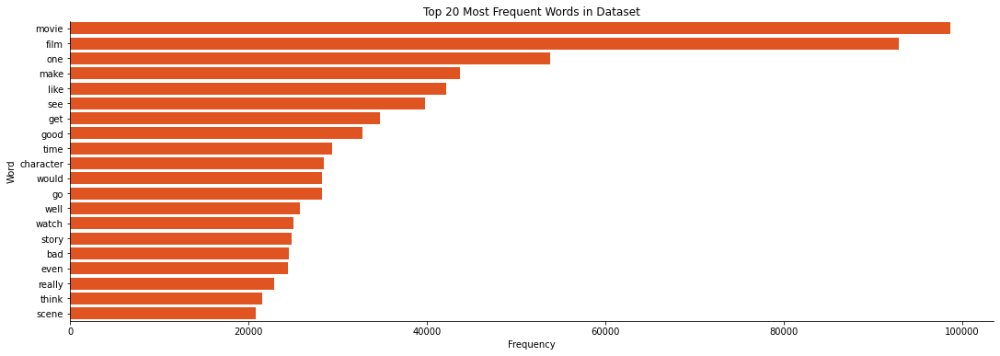

In [95]:
#Question 2(c)
#Finding top 20 words and making graph 
import seaborn as sns
fig, ax = plt.subplots(figsize=(18,6))
sns.barplot(data=frequency_data.sort_values(by="frequency", ascending=False).head(20), 
            y="word", 
            x="frequency", 
            color='#FF4500')
plt.ylabel("Word")
plt.xlabel("Frequency")
plt.title("Top 20 Most Frequent Words in Dataset")
sns.despine();

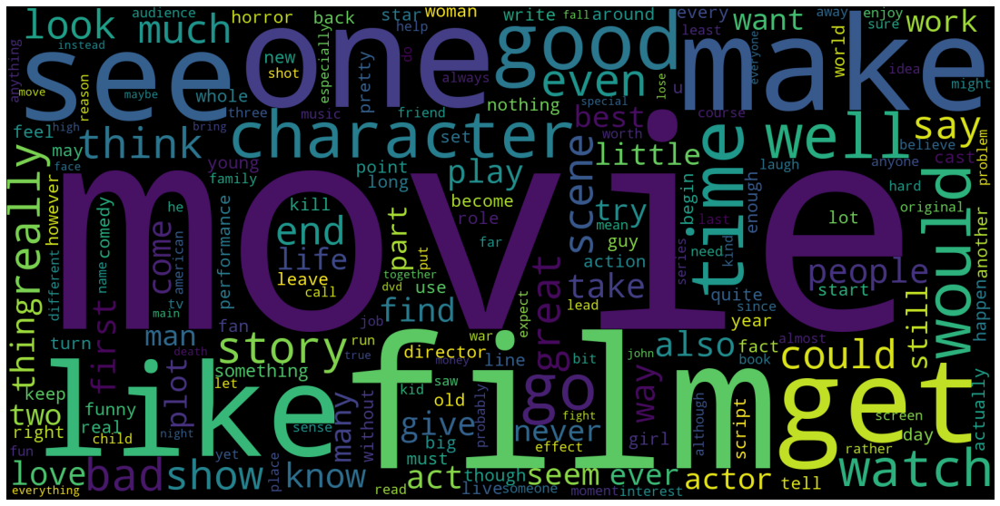

In [98]:
#question 2(d)
# BUILD WORD CLOUD
#install library
!pip install wordcloud

#build wordcloud
from wordcloud import WordCloud
wcloud = WordCloud(width=1600, height=800).generate_from_frequencies(all_word_freq)

#plotting the wordcloud
import matplotlib.pyplot as plt
plt.figure( figsize=(20,10))
plt.imshow(wcloud)
plt.axis("off")
plt.show()

Part 3 starts from here

TF-IDF features

Part C: Feature engineering

1) Convert the text data to features using the Bag of Words (BOW) algorithm, specifically the tri-gram model

In [99]:
from sklearn.feature_extraction.text import TfidfVectorizer
tfidf = TfidfVectorizer(max_features=50)
vect = tfidf.fit_transform([' '.join(x) for x in data_f['lemmatized']])

2) Convert the text data to a matrix of TF-IDF features utilizing appropriate arguments

In [100]:
vect.toarray()

array([[0.17749051, 0.        , 0.        , ..., 0.        , 0.        ,
        0.15165361],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.1560231 , 0.        , 0.        , ..., 0.        , 0.17307967,
        0.        ],
       ...,
       [0.        , 0.35478048, 0.31736226, ..., 0.        , 0.        ,
        0.36429343],
       [0.        , 0.        , 0.13001204, ..., 0.11171905, 0.        ,
        0.        ],
       [0.        , 0.        , 0.24122205, ..., 0.        , 0.        ,
        0.        ]])

In [101]:
vect.toarray()[5]

array([0.        , 0.3644551 , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.29038536, 0.21039657,
       0.        , 0.        , 0.        , 0.        , 0.27759338,
       0.26055611, 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.19891618, 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.35566301, 0.        , 0.        , 0.32591986,
       0.23800762, 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.36319849, 0.        ,
       0.        , 0.        , 0.        , 0.36439838, 0.        ])